In [13]:
import librosa as libr
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
import pretty_midi
import IPython.display as ipd

import os

In [3]:
midi_path = 'test_data/MIDI-Unprocessed_041_PIANO041_MID--AUDIO-split_07-06-17_Piano-e_1-01_wav--1.midi'
wav_path = 'test_data/MIDI-Unprocessed_041_PIANO041_MID--AUDIO-split_07-06-17_Piano-e_1-01_wav--1.wav'

midi_file = open(midi_path,'r')
wav_file = open(wav_path, 'r')

In [4]:
au, sr = libr.load(wav_path, sr=44100)
ipd.Audio(au, rate=sr)

In [5]:
au_down, sr_down = libr.load(wav_path, sr=16000)
ipd.Audio(au_down, rate=sr_down)


In [6]:
print(au_down.shape)
print(au.shape)

(2432284,)
(6703981,)


In [277]:
min_midi = 21 # A0
max_midi = 108 # C8
bins_p_octave_mult = 1
bins_p_ocatave = bins_p_octave_mult * 12
fmin = libr.midi_to_hz(min_midi)
n_bins = (max_midi - min_midi + 1) * bins_p_octave_mult


proc_input = libr.cqt(au_down, window='hamming', sr=sr_down, hop_length=512, fmin=fmin, n_bins=n_bins, bins_per_octave=bins_p_ocatave)
proc_input = np.abs(proc_input)
print(proc_input.shape)
#frame amount: 4751. piece length: 152 seconds. frame rate: 4751/152 = 31.25 frame/sec
print(proc_input[:3])

(88, 4751)
[[0.00081975 0.00092466 0.00117398 ... 0.0022949  0.00240933 0.00245939]
 [0.00196423 0.00203508 0.00206535 ... 0.00213112 0.00131428 0.00042872]
 [0.00100686 0.00126129 0.00176477 ... 0.00376199 0.0036601  0.00362138]]


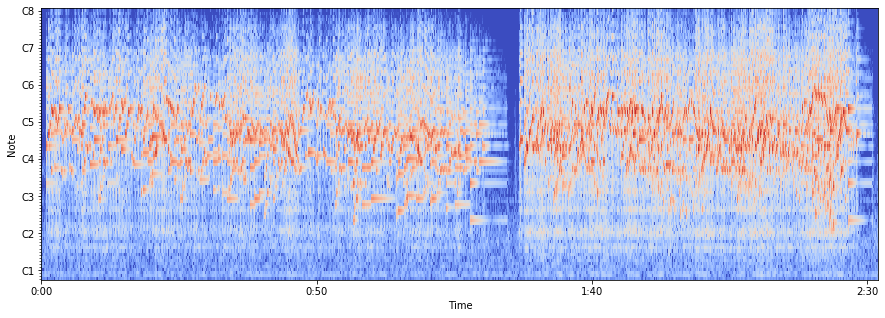

In [278]:
logC = libr.amplitude_to_db(proc_input)
plt.figure(figsize=(15, 5))
libr.display.specshow(logC, sr=sr_down, x_axis='time', y_axis='cqt_note', fmin=fmin, cmap='coolwarm')

In [279]:
proc_input = proc_input.T
print(proc_input.shape)

(4751, 88)


In [280]:
mean = np.mean(proc_input, axis=0)
std = np.std(proc_input, axis=0)
print(mean.shape)
print(std.shape)

# proc_input_norm = (proc_input - mean)/std
proc_input_norm = proc_input
print(proc_input_norm.shape)


(88,)
(88,)
(4751, 88)


In [281]:
x_train = proc_input_norm
print(x_train.shape)

(4751, 88)


In [282]:
times = libr.frames_to_time(np.arange(proc_input_norm.shape[0]), sr=sr_down, hop_length=512)

In [283]:
print(times)

[0.00000e+00 3.20000e-02 6.40000e-02 ... 1.51936e+02 1.51968e+02
 1.52000e+02]


In [284]:
pm = pretty_midi.PrettyMIDI(midi_path)
print(pm)

In [285]:
piano_roll = pm.get_piano_roll(times=times, fs=32)[min_midi:max_midi+1].T
print(piano_roll.shape)
piano_roll[piano_roll > 0] = 1
y_train = piano_roll

(4751, 88)


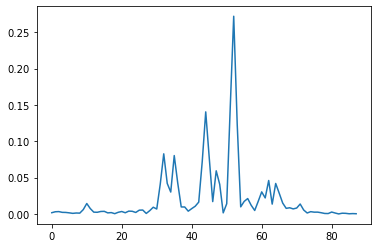

In [294]:
plt.plot(x_train[900])

[[37]
 [49]]


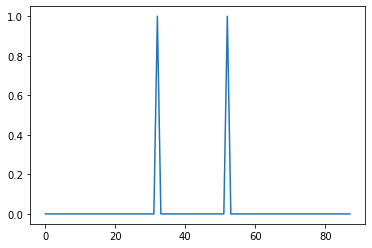

In [295]:
plt.plot(y_train[900])
print(np.argwhere(y_train[790] > 0))